<a href="https://colab.research.google.com/github/VisheshJain112/Extracting-and-sentiment-analysis-of-Financial-Documents/blob/master/Financial_Statements_NLP_and_Alpha_vector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install nltk

In [ ]:
!pip install tqdm

In [ ]:
import nltk
nltk.download("wordnet")
nltk.download("stopwords")

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
cik_lookup = {
    'AMZN': '0001018724',
    'BMY': '0000014272',   
    'CNP': '0001130310',
    'CVX': '0000093410',
    'FL': '0000850209',
    'FRT': '0000034903',
    'HON': '0000773840'}

additional_cik = {
    'AEP': '0000004904',
    'AXP': '0000004962',
    'BA': '0000012927', 
    'BK': '0001390777',
    'CAT': '0000018230',
    'DE': '0000315189',
    'DIS': '0001001039',
    'DTE': '0000936340',
    'ED': '0001047862',
    'EMR': '0000032604',
    'ETN': '0001551182',
    'GE': '0000040545',
    'IBM': '0000051143',
    'IP': '0000051434',
    'JNJ': '0000200406',
    'KO': '0000021344',
    'LLY': '0000059478',
    'MCD': '0000063908',
    'MO': '0000764180',
    'MRK': '0000310158',
    'MRO': '0000101778',
    'PCG': '0001004980',
    'PEP': '0000077476',
    'PFE': '0000078003',
    'PG': '0000080424',
    'PNR': '0000077360',
    'SYY': '0000096021',
    'TXN': '0000097476',
    'UTX': '0000101829',
    'WFC': '0000072971',
    'WMT': '0000104169',
    'WY': '0000106535',
    'XOM': '0000034088'}

In [ ]:
from bs4 import BeautifulSoup
import requests
import pandas as pd
import pprint
from tqdm import tqdm
def get_sec_data(cik, doc_type, start=0, count=60):
    newest_pricing_data = pd.to_datetime('2018-01-01')
    rss_url = 'https://www.sec.gov/cgi-bin/browse-edgar?action=getcompany' \
        '&CIK={}&type={}&start={}&count={}&owner=exclude&output=atom' \
        .format(cik, doc_type, start, count)
    sec_data = requests.get(rss_url).text
    feed = BeautifulSoup(sec_data.encode('ascii'), 'xml').feed
    
    entries = [
        (
            entry.content.find('filing-href').getText(),
            entry.content.find('filing-type').getText(),
            entry.content.find('filing-date').getText())
        
        for entry in feed.find_all('entry', recursive=False)
        if pd.to_datetime(entry.content.find('filing-date').getText()) <= newest_pricing_data]

    return entries
sec_data={}
doc_type='10-K'
for ticker,cik in cik_lookup.items():
  sec_data[ticker]=get_sec_data(cik,doc_type=doc_type)
example_ticker='AMZN'
pprint.pprint(sec_data[example_ticker][:5])


[('https://www.sec.gov/Archives/edgar/data/1018724/000101872417000011/0001018724-17-000011-index.htm',
  '10-K',
  '2017-02-10'),
 ('https://www.sec.gov/Archives/edgar/data/1018724/000101872416000172/0001018724-16-000172-index.htm',
  '10-K',
  '2016-01-29'),
 ('https://www.sec.gov/Archives/edgar/data/1018724/000101872415000006/0001018724-15-000006-index.htm',
  '10-K',
  '2015-01-30'),
 ('https://www.sec.gov/Archives/edgar/data/1018724/000101872414000006/0001018724-14-000006-index.htm',
  '10-K',
  '2014-01-31'),
 ('https://www.sec.gov/Archives/edgar/data/1018724/000119312513028520/0001193125-13-028520-index.htm',
  '10-K',
  '2013-01-30')]


In [ ]:

raw_fillings_by_ticker = {}

for ticker, data in sec_data.items():
    raw_fillings_by_ticker[ticker] = {}
    for index_url, file_type, file_date in tqdm(data, desc='Downloading {} Fillings'.format(ticker), unit='filling'):
        if (file_type == '10-K'):
            file_url = index_url.replace('-index.htm', '.txt').replace('.txtl', '.txt')            
            
            raw_fillings_by_ticker[ticker][file_date] = requests.get(file_url).text


print('Example Document:\n\n{}...'.format(next(iter(raw_fillings_by_ticker[example_ticker].values()))[:1000]))

Example Document:

<SEC-DOCUMENT>0001018724-17-000011.txt : 20170210
<SEC-HEADER>0001018724-17-000011.hdr.sgml : 20170210
<ACCEPTANCE-DATETIME>20170209175636
ACCESSION NUMBER:		0001018724-17-000011
CONFORMED SUBMISSION TYPE:	10-K
PUBLIC DOCUMENT COUNT:		92
CONFORMED PERIOD OF REPORT:	20161231
FILED AS OF DATE:		20170210
DATE AS OF CHANGE:		20170209

FILER:

	COMPANY DATA:	
		COMPANY CONFORMED NAME:			AMAZON COM INC
		CENTRAL INDEX KEY:			0001018724
		STANDARD INDUSTRIAL CLASSIFICATION:	RETAIL-CATALOG & MAIL-ORDER HOUSES [5961]
		IRS NUMBER:				911646860
		STATE OF INCORPORATION:			DE
		FISCAL YEAR END:			1231

	FILING VALUES:
		FORM TYPE:		10-K
		SEC ACT:		1934 Act
		SEC FILE NUMBER:	000-22513
		FILM NUMBER:		17588807

	BUSINESS ADDRESS:	
		STREET 1:		410 TERRY AVENUE NORTH
		CITY:			SEATTLE
		STATE:			WA
		ZIP:			98109
		BUSINESS PHONE:		2062661000

	MAIL ADDRESS:	
		STREET 1:		410 TERRY AVENUE NORTH
		CITY:			SEATTLE
		STATE:			WA
		ZIP:			98109
</SEC-HEADER>
<DOCUMENT>
<TYPE>10-K
<S

In [ ]:
from time import sleep
for i in (['a','b','v']):
  for i in tqdm(i , desc='Printing {}'.format(i), unit='horahi'):
 
    sleep(3.0)
    print(i)


Printing b:   0%|          | 0/1 [00:00<?, ?horahi/s]

a


Printing v:   0%|          | 0/1 [00:00<?, ?horahi/s]

b


Printing v: 100%|██████████| 1/1 [00:03<00:00,  3.00s/horahi]

v


In [ ]:

import re


def get_documents(text):
    """
    Extract the documents from the text

    Parameters
    ----------
    text : str
        The text with the document strings inside

    Returns
    -------
    extracted_docs : list of str
        The document strings found in `text`
    """
    
    # TODO: Implement
    doc_start_pattern = re.compile(r'<DOCUMENT>')
    doc_end_pattern = re.compile(r'</DOCUMENT>')
    
    doc_start = [x.end() for x in doc_start_pattern.finditer(text)]
    doc_end = [x.start() for x in doc_end_pattern.finditer(text)]
    
    doc_found = [text[start:end] for start, end in zip(doc_start, doc_end)]
    
    return doc_found



In [ ]:
filling_documents_by_ticker = {}

for ticker, raw_fillings in raw_fillings_by_ticker.items():
    filling_documents_by_ticker[ticker] = {}
    for file_date, filling in tqdm(raw_fillings.items(), desc='Getting Documents from {} Fillings'.format(ticker), unit='filling'):
        filling_documents_by_ticker[ticker][file_date] = get_documents(filling)


print('\n\n'.join([
    'Document {} Filed on {}:\n{}...'.format(doc_i, file_date, doc[:200])
    for file_date, docs in filling_documents_by_ticker[example_ticker].items()
    for doc_i, doc in enumerate(docs)][:3]))

Getting Documents from HON Fillings: 100%|██████████| 20/20 [00:00<00:00, 48.58filling/s]

Document 0 Filed on 2017-02-10:

<TYPE>10-K
<SEQUENCE>1
<FILENAME>amzn-20161231x10k.htm
<DESCRIPTION>FORM 10-K
<TEXT>
<!DOCTYPE html PUBLIC "-//W3C//DTD HTML 4.01 Transitional//EN" "http://www.w3.org/TR/html4/loose.dtd">
<html>
	<he...

Document 1 Filed on 2017-02-10:

<TYPE>EX-12.1
<SEQUENCE>2
<FILENAME>amzn-20161231xex121.htm
<DESCRIPTION>COMPUTATION OF RATIO OF EARNINGS TO FIXED CHARGES
<TEXT>
<!DOCTYPE html PUBLIC "-//W3C//DTD HTML 4.01 Transitional//EN" "http:...

Document 2 Filed on 2017-02-10:

<TYPE>EX-21.1
<SEQUENCE>3
<FILENAME>amzn-20161231xex211.htm
<DESCRIPTION>LIST OF SIGNIFICANT SUBSIDIARIES
<TEXT>
<!DOCTYPE html PUBLIC "-//W3C//DTD HTML 4.01 Transitional//EN" "http://www.w3.org/TR/h...


In [ ]:
def get_document_type(doc):
   
    
    # TODO: Implement
    regex = re.compile(r'<TYPE>.+')
    l = len('<TYPE>')
    matches = regex.finditer(doc)
    doc_type = None
    for match in matches:
        doc_type = doc[match.span()[0]+l:match.span()[1]].rstrip().lower()
    
    return doc_type



In [ ]:
ten_ks_by_ticker = {}

for ticker, filling_documents in filling_documents_by_ticker.items():
    ten_ks_by_ticker[ticker] = []
    for file_date, documents in filling_documents.items():
        for document in documents:
            if get_document_type(document) == '10-k':
                ten_ks_by_ticker[ticker].append({
                    'cik': cik_lookup[ticker],
                    'file': document,
                    'file_date': file_date})
def print_ten_k_data(ten_k_data, fields, field_length_limit=50):
    indentation = '  '

    print('[')
    for ten_k in ten_k_data:
        print_statement = '{}{{'.format(indentation)
        for field in fields:
            value = str(ten_k[field])

  
            if isinstance(value, str):
                value_str = '\'{}\''.format(value.replace('\n', '\\n'))
            else:
                value_str = str(value)

          
            if len(value_str) > field_length_limit:
                value_str = value_str[:field_length_limit] + '...'

            print_statement += '\n{}{}: {}'.format(indentation * 2, field, value_str)

        print_statement += '},'
        print(print_statement)
    print(']')


print_ten_k_data(ten_ks_by_ticker[example_ticker][:5], ['cik', 'file', 'file_date'])

[
  {
    cik: '0001018724'
    file: '\n<TYPE>10-K\n<SEQUENCE>1\n<FILENAME>amzn-2016123...
    file_date: '2017-02-10'},
  {
    cik: '0001018724'
    file: '\n<TYPE>10-K\n<SEQUENCE>1\n<FILENAME>amzn-2015123...
    file_date: '2016-01-29'},
  {
    cik: '0001018724'
    file: '\n<TYPE>10-K\n<SEQUENCE>1\n<FILENAME>amzn-2014123...
    file_date: '2015-01-30'},
  {
    cik: '0001018724'
    file: '\n<TYPE>10-K\n<SEQUENCE>1\n<FILENAME>amzn-2013123...
    file_date: '2014-01-31'},
  {
    cik: '0001018724'
    file: '\n<TYPE>10-K\n<SEQUENCE>1\n<FILENAME>d445434d10k....
    file_date: '2013-01-30'},
]


In [ ]:

def remove_html_tags(text):
    text = BeautifulSoup(text, 'html.parser').get_text()
    
    return text


def clean_text(text):
    text = text.lower()
    text = remove_html_tags(text)
    
    return text

In [ ]:
for ticker, ten_ks in ten_ks_by_ticker.items():
    for ten_k in tqdm(ten_ks, desc='Cleaning {} 10-Ks'.format(ticker), unit='10-K'):
        ten_k['file_clean'] = clean_text(ten_k['file'])



Cleaning HON 10-Ks: 100%|██████████| 20/20 [00:39<00:00,  2.00s/10-K]


In [ ]:

from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet


def lemmatize_words(words):
   
    
    return [WordNetLemmatizer().lemmatize(word, 'v') for word in words]


In [ ]:
import re
word_pattern = re.compile('\w+')

for ticker, ten_ks in ten_ks_by_ticker.items():
    for ten_k in tqdm(ten_ks, desc='Lemmatize {} 10-Ks'.format(ticker), unit='10-K'):
        print(word_pattern.findall(ten_k['file_clean']))
        ten_k['file_lemma'] = lemmatize_words(word_pattern.findall(ten_k['file_clean']))


Lemmatize AMZN 10-Ks:   0%|          | 0/17 [00:00<?, ?10-K/s]

['10', 'k', '1', 'amzn', '20161231x10k', 'htm', 'form', '10', 'k', 'document', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549', '____________________________________form', '10', 'k____________________________________', 'mark', 'one', 'xannual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2016', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'no', '000', '22513____________________________________amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'i', 'r', 's', 'employeridentification', 'no', 

Lemmatize AMZN 10-Ks:  12%|█▏        | 2/17 [00:02<00:22,  1.50s/10-K]

['10', 'k', '1', 'amzn', '20151231x10k', 'htm', 'form', '10', 'k', '10', 'k', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549', '____________________________________form', '10', 'k____________________________________', 'mark', 'one', 'xannual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2015', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'no', '000', '22513____________________________________amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'i', 'r', 's', 'employeridentification', 'no', '

Lemmatize AMZN 10-Ks:  24%|██▎       | 4/17 [00:02<00:11,  1.1710-K/s]

['10', 'k', '1', 'amzn', '20131231x10k', 'htm', 'form', '10', 'k', 'amzn', '2013', '12', '31', '10k', 'table', 'of', 'contents', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549', '____________________________________form', '10', 'k____________________________________', 'mark', 'one', 'xannual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2013or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'no', '000', '22513____________________________________amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', '

Lemmatize AMZN 10-Ks:  35%|███▌      | 6/17 [00:03<00:05,  1.8610-K/s]

['10', 'k', '1', 'd269317d10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2011', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'no', '000', '22513', 'amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', '410', 'terry', 'avenue', 'north', 'seattle', 'wash

Lemmatize AMZN 10-Ks:  47%|████▋     | 8/17 [00:03<00:03,  2.7510-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2009', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'no', '000', '22513', 'amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', '1200', '12th', 'avenue', 'south', 'suite', '1200', 'seatt

Lemmatize AMZN 10-Ks:  59%|█████▉    | 10/17 [00:04<00:02,  3.3310-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize AMZN 10-Ks:  94%|█████████▍| 16/17 [00:05<00:00,  4.7710-K/s]

['10', 'k', '1', 'form', '10', 'k', 'for', 'period', 'ending', '12', '31', '1999', '1', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1999', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', '____________', 'to', '____________', 'commission', 'file', 'no', '000', '22513', 'amazon', 'com', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '91', '1646860', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'i', 'r', 's', 'employer', 'identification', 'no', 'or', 'organization', '1200', '12th', 'avenue', 'south', 

Lemmatize BMY 10-Ks:   0%|          | 0/23 [00:00<?, ?10-K/s]

['10', 'k', '1', 'bmy', '20161231x10xk', 'htm', '10', 'k', 'document', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549_______________form', '10', 'k_______________', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'thesecurities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2016commission', 'file', 'number', '1', '1136_______________bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '________________delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'irs', 'employeridentification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'title', 'of', 'each', 'class',

Lemmatize BMY 10-Ks:   4%|▍         | 1/23 [00:00<00:08,  2.6910-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize BMY 10-Ks:   9%|▊         | 2/23 [00:00<00:07,  2.6310-K/s]

['10', 'k', '1', 'bmy', '20141231x10xk', 'htm', '10', 'k', 'bmy', '2014', '12', '31', '10', 'k', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549_______________form', '10', 'k_______________', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'thesecurities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2014commission', 'file', 'number', '1', '1136_______________bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '________________delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'irs', 'employeridentification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'titl

Lemmatize BMY 10-Ks:  13%|█▎        | 3/23 [00:01<00:07,  2.6210-K/s]

['10', 'k', '1', 'bmy', '20131231x10xk', 'htm', 'form', '10', 'k', 'bmy', '2013', '12', '31', '10', 'k', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549_______________form', '10', 'k_______________', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'thesecurities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2013commission', 'file', 'number', '1', '1136_______________bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '________________delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'irs', 'employeridentification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act

Lemmatize BMY 10-Ks:  17%|█▋        | 4/23 [00:01<00:07,  2.4110-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize BMY 10-Ks:  35%|███▍      | 8/23 [00:03<00:06,  2.3810-K/s]

['10', 'k', '1', 'd10k', 'htm', 'quarterly', 'report', 'for', 'the', 'period', 'ended', 'december', '31', '2008', 'quarterly', 'report', 'for', 'the', 'period', 'ended', 'december', '31', '2008', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2008', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'irs', 'employer', 'identification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '54

Lemmatize BMY 10-Ks:  39%|███▉      | 9/23 [00:03<00:06,  2.1810-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2007', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'irs', 'employer', 'identification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'title', 'of', 'each', 'cl

Lemmatize BMY 10-Ks:  43%|████▎     | 10/23 [00:04<00:06,  2.0310-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2006', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '0790350', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'irs', 'employer', 'identification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'title', 'of', 'each', 'class', 'name', 'of', 'each',

Lemmatize BMY 10-Ks:  48%|████▊     | 11/23 [00:05<00:07,  1.6710-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize BMY 10-Ks:  61%|██████    | 14/23 [00:06<00:04,  1.9710-K/s]

['10', 'k', '1', 'a2106681z10', 'k', 'htm', '10', 'k', 'quicklinks', 'click', 'here', 'to', 'rapidly', 'navigate', 'through', 'this', 'document', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2002', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', '22', '079', '0350', 'irs', 'employer', 'identification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 

Lemmatize BMY 10-Ks:  70%|██████▉   | 16/23 [00:07<00:02,  2.8610-K/s]

['10', 'k', '1', 'r10k1231', 'htm', 'part', 'i', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2000', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '079', '0350', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'irs', 'employer', 'identification', 'no', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'title', 'of', 'each', 'class', 'name', 'of', 'each', 'exchange', 'on', 'which', 'reg

Lemmatize BMY 10-Ks:  78%|███████▊  | 18/23 [00:07<00:01,  4.1310-K/s]

['10', 'k', '1', 'form', '10', 'k', 'fiscal', 'year', 'ended', 'december', '31', '1998', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1998', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '079', '0350', 'state', 'or', 'other', 'jurisdiction', 'of', 'irs', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'name', 'of', 'each', 'exchange', 'on', 'titl

Lemmatize BMY 10-Ks:  87%|████████▋ | 20/23 [00:07<00:00,  5.0310-K/s]

['10', 'k', '1', 'form', '10', 'k', 'fiscal', 'year', 'ended', 'december', '31', '1996', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1996', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '079', '0350', 'state', 'or', 'other', 'jurisdiction', 'of', 'irs', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'name', 'of', 'each', 'exchange', 'on', 'titl

Lemmatize BMY 10-Ks:  96%|█████████▌| 22/23 [00:07<00:00,  6.1910-K/s]

['10', 'k', '1', 'form', '10', 'k', 'fiscal', 'year', 'ended', 'december', '31', '1994', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'fee', 'required', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1994', 'commission', 'file', 'number', '1', '1136', 'bristol', 'myers', 'squibb', 'company', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '079', '0350', 'state', 'or', 'other', 'jurisdiction', 'of', 'irs', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '345', 'park', 'avenue', 'new', 'york', 'n', 'y', '10154', 'address', 'of', 'principal', 'executive', 'offices', 'telephone', '212', '546', '4000', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'name', 'of', 'each', 'exc

Lemmatize CNP 10-Ks:   0%|          | 0/15 [00:00<?, ?10-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize CNP 10-Ks:  27%|██▋       | 4/15 [00:01<00:04,  2.3710-K/s]

['10', 'k', '1', 'cnp_10kx12312012', 'htm', '10', 'k', 'cnp_10k_12', '31', '2012', 'united', 'states', 'securities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549______________________form', '10', 'k', 'mark', 'one', 'þannual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2012orotransition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447______________________centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', '1111', 'louisianahouston', 'texas', '77002', 'a

Lemmatize CNP 10-Ks:  33%|███▎      | 5/15 [00:02<00:03,  2.5310-K/s]

['10', 'k', '1', 'cnp_10kx12312011', 'htm', 'form', '10', 'k', 'december', '31', '2011', 'cnp_10k_12', '31', '2011', 'united', 'states', 'securities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549______________________form', '10', 'k', 'mark', 'one', 'þannual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2011orotransition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447______________________centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', '1111', 'louis

Lemmatize CNP 10-Ks:  40%|████      | 6/15 [00:02<00:03,  2.4510-K/s]

['10', 'k', '1', 'form10', 'k', 'htm', 'form', '10', 'k', 'december', '31', '2010', 'form10', 'k', 'htm', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', '______________________', 'form', '10', 'k', 'mark', 'one', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2010', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447', '______________________', 'centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas', '74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identifi

Lemmatize CNP 10-Ks:  47%|████▋     | 7/15 [00:02<00:03,  2.4610-K/s]

['10', 'k', '1', 'form10', 'k', 'htm', 'form', '10', 'k', 'december', '31', '2009', 'form10', 'k', 'htm', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', '______________________', 'form', '10', 'k', 'mark', 'one', 'r', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2009', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447', '______________________', 'centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas', '74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identificatio

Lemmatize CNP 10-Ks:  53%|█████▎    | 8/15 [00:03<00:03,  2.2710-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize CNP 10-Ks:  87%|████████▋ | 13/15 [00:05<00:00,  2.5110-K/s]

['10', 'k', '1', 'h13311e10vk', 'txt', 'centerpoint', 'energy', 'inc', 'december', '31', '2003', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2003', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447', 'centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas', '74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'i', 'r', 's', 'employer', 'of', 'incorporation', 'or', 'organization', 'identification', 'no', '1111', 'louisiana', '713', '207', '1111', 'houston

Lemmatize CNP 10-Ks:  93%|█████████▎| 14/15 [00:05<00:00,  2.4010-K/s]

['10', 'k', '1', 'h03755e10vk', 'txt', 'centerpoint', 'energy', 'inc', 'dated', '12', '31', '2002', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2002', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '31447', 'centerpoint', 'energy', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'texas', '74', '0694415', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'incorporation', 'or', 'organization', 'identification', 'no', '1111', 'louisiana', '713', '207', '1111', 'hous

Lemmatize CVX 10-Ks:   0%|          | 0/21 [00:00<?, ?10-K/s]

['10', 'k', '1', 'cvx', '123116x10kdoc', 'htm', '10', 'k', 'document', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2016oro', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'thesecurities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '001', '00368', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', 'address', 'of', '

Lemmatize CVX 10-Ks:   5%|▍         | 1/21 [00:00<00:08,  2.3610-K/s]

['10', 'k', '1', 'cvx', '123115x10kdoc', 'htm', '10', 'k', '10', 'k', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2015', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'thesecurities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '001', '00368', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'identification', 'no', 'address', 

Lemmatize CVX 10-Ks:  10%|▉         | 2/21 [00:00<00:08,  2.3610-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize CVX 10-Ks:  33%|███▎      | 7/21 [00:02<00:05,  2.5710-K/s]

['10', 'k', '1', 'f54086e10vk', 'htm', 'form', '10', 'k', 'e10vk', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2009', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'i

Lemmatize CVX 10-Ks:  38%|███▊      | 8/21 [00:03<00:05,  2.5010-K/s]

['10', 'k', '1', 'f50714e10vk', 'htm', 'form', '10', 'k', 'e10vk', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2008', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'i

Lemmatize CVX 10-Ks:  43%|████▎     | 9/21 [00:03<00:04,  2.4110-K/s]

['10', 'k', '1', 'f37829e10vk', 'htm', 'form', '10', 'k', 'e10vk', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2007', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'i

Lemmatize CVX 10-Ks:  48%|████▊     | 10/21 [00:03<00:04,  2.4210-K/s]

['10', 'k', '1', 'f27542e10vk', 'htm', 'form', '10', 'k', 'e10vk', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2006', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', '6001', 'bollinger', 'canyon', 'road', 'san', 'ramon', 'california', '94583', '2324', 'state', 'or', 'other', 'jurisdiction', 'of', 'incorporation', 'or', 'organization', 'i', 'r', 's', 'employer', 'i

Lemmatize CVX 10-Ks:  52%|█████▏    | 11/21 [00:04<00:04,  2.3210-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize CVX 10-Ks:  76%|███████▌  | 16/21 [00:06<00:01,  3.1110-K/s]

['10', 'k', '1', '0001', 'txt', 'chevron', 'corporation', '2000', 'form', '10', 'k', '2000', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2000', 'or', '_', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '94', '0890210', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'incorporation', 'or', 'organization', 'identification', 'number', '575', 'market', 'street', 'san', 'francisco', 'california', 

Lemmatize CVX 10-Ks:  81%|████████  | 17/21 [00:06<00:01,  3.2010-K/s]

['10', 'k', '1', 'chevron', 'corporation', '1998', 'form', '10', 'k', '1998', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1998', 'or', '_', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '575', 'market', 'street', 'delaware', '94', '0890210', 'san', 'francisco', 'california', '94105', 'state', 'or', 'other', 'i', 'r', 's', 'employer', 'address', 'of', 'principal', 'zip', 'code', 'jurisdiction', 'of', 'identification', 'executive

Lemmatize CVX 10-Ks:  86%|████████▌ | 18/21 [00:06<00:00,  3.0510-K/s]

['10', 'k', '1', 'chevron', 'corporation', '1995', 'form', '10', 'k', '1995', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1995', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', '__________________', 'to', '__________________', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '575', 'market', 'street', 'delaware', '94', '0890210', 'san', 'francisco', 'california', '94105', 'state', 'or', 'other', 'i', 'r', 's', 'employer', 'address', 'of', 'principal', 'zip', 'code', 'jurisdicti

Lemmatize CVX 10-Ks:  90%|█████████ | 19/21 [00:07<00:00,  3.2810-K/s]

['10', 'k', '1', 'chevron', 'corporation', '1994', 'form', '10', 'k', '1994', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1994', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '225', 'bush', 'street', 'delaware', '94', '0890210', 'san', 'francisco', 'california', '94104', 'state', 'or', 'other', 'i', 'r', 's', 'employer', 'address', 'of', 'principal', 'zip', 'code', 'jurisdiction', 'of', 'identification', 'number', 'execut

Lemmatize CVX 10-Ks:  95%|█████████▌| 20/21 [00:07<00:00,  3.2810-K/s]

['10', 'k', '1', 'chevron', 'corporation', '1993', 'form', '10', 'k', '1993', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1993', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '368', '2', 'chevron', 'corporation', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', '225', 'bush', 'street', 'delaware', '94', '0890210', 'san', 'francisco', 'california', '94104', 'state', 'or', 'other', 'i', 'r', 's', 'employer', 'address', 'of', 'principal', 'zip', 'code', 'jurisdiction', 'of', 'identification', 'number', 'execut

Lemmatize FL 10-Ks:   0%|          | 0/16 [00:00<?, ?10-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize FL 10-Ks:  44%|████▍     | 7/16 [00:01<00:01,  4.6610-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize FL 10-Ks:  56%|█████▋    | 9/16 [00:01<00:01,  4.7110-K/s]

['10', 'k', '1', 'footlocker_10k', 'htm', 'annual', 'report', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549___________________', 'form', '10', 'k___________________', 'mark', 'one', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'january', '31', '2009', 'or', 'c', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', '__________', 'to', '__________', 'commission', 'file', 'no', '1', '10299', 'foot', 'locker', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'new', 'york', '13', '3513936', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '112', 'west', '34th', 'stree

Lemmatize FL 10-Ks:  69%|██████▉   | 11/16 [00:02<00:01,  4.5810-K/s]

['10', 'k', '1', 'footlocker_10k', 'htm', 'annual', 'report', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549_____________________', 'form', '10', 'k_____________________', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'february', '3', '2007', 'commission', 'file', 'number', '1', '10299foot', 'locker', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'new', 'york', '13', '3513936', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '112', 'west', '34th', 'street', 'new', 'york', 'new', 'york', '10120', 'address', 'of', 'principal', 'executive', 'offices', 'zip', 'code', 'registrant', 's', 'telephone', 'number', 'including', 'area', 'code', '212', '720', '3700', 'securities', 'registered', 'pursuant', 't

Lemmatize FL 10-Ks:  81%|████████▏ | 13/16 [00:02<00:00,  4.8810-K/s]

['10', 'k', '1', 'd16563', 'htm', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'january', '29', '2005', 'commission', 'file', 'number', '1', '10299', 'foot', 'locker', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'new', 'york', '13', '3513936', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '112', 'west', '34th', 'street', 'new', 'york', 'new', 'york', '10120', 'address', 'of', 'principal', 'executive', 'offices', 'zip', 'code', 'registrant', 's', 'telephone', 'number', 'including', 'area', 'code', '212', '720', '3700', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act', 'title', 'of', 'each', 'clas

Lemmatize FRT 10-Ks:   0%|          | 0/19 [00:00<?, ?10-K/s]

['10', 'k', '1', 'y85989e10vk', 'txt', 'foot', 'locker', 'inc', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'february', '1', '2003', 'commission', 'file', 'number', '1', '10299', 'foot', 'locker', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'new', 'york', '13', '3513936', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'identification', 'no', 'incorporation', 'or', 'organization', '112', 'west', '34th', 'street', 'new', 'york', 'new', 'york', '10120', 'address', 'of', 'principal', 'executive', 'offices', 'zip', 'code', 'registrant', 's', 'telephone', 'number', 'including', 'area', 'code', '212', '720', '3700', 'securities', 'registered', 'pursuant', 'to', 'section', '12', 'b', 'of', 'the', 'act'

Lemmatize FRT 10-Ks:   5%|▌         | 1/19 [00:00<00:05,  3.3210-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize FRT 10-Ks:  42%|████▏     | 8/19 [00:02<00:02,  3.7610-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'the', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2008', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '07533', 'federal', 'realty', 'investment', 'trust', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'declaration', 'of', 'trust', 'maryland', '52', '0782497', 'state', 'of', 'organization', 'irs', 'employer', 'identification', 'no', '1626', 'east', 'jefferson', 'street', 'rockville', 'maryland', '20852', 'address', 'of

Lemmatize FRT 10-Ks:  47%|████▋     | 9/19 [00:02<00:02,  3.7710-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'the', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2007', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '07533', 'federal', 'realty', 'investment', 'trust', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'declaration', 'of', 'trust', 'maryland', '52', '0782497', 'state', 'of', 'organization', 'irs', 'employer', 'identification', 'no', '1626', 'east', 'jefferson', 'street', 'rockville', 'maryland', '20852', 'address', 'of

Lemmatize FRT 10-Ks:  58%|█████▊    | 11/19 [00:02<00:02,  3.6610-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'the', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2006', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '07533', 'federal', 'realty', 'investment', 'trust', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'declaration', 'of', 'trust', 'maryland', '52', '0782497', 'state', 'of', 'organization', 'irs', 'employer', 'identification', 'no', '1626', 'east', 'jefferson', 'street', 'rockville', 'maryland', '20852', 'address', 'of

Lemmatize FRT 10-Ks:  68%|██████▊   | 13/19 [00:03<00:01,  3.8210-K/s]

['10', 'k', '1', 'd10k', 'htm', 'form', '10', 'k', 'form', '10', 'k', 'table', 'of', 'contents', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'þ', 'annual', 'report', 'pursuant', 'to', 'the', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2004', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '07533', 'federal', 'realty', 'investment', 'trust', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'declaration', 'of', 'trust', 'maryland', 'state', 'of', 'organization', '1626', 'east', 'jefferson', 'street', 'rockville', 'maryland', 'address', 'of', 'principal', 'executive', 'offices', '52', '0782497', 'irs', 'empl

Lemmatize FRT 10-Ks:  74%|███████▎  | 14/19 [00:03<00:01,  3.8010-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize HON 10-Ks:  20%|██        | 4/20 [00:00<00:03,  4.2710-K/s]

['10', 'k', '1', 'c72130_10', 'k', 'htm', '3b2', 'edgar', 'html', 'c72130_preflight', 'htm', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549', 'form', '10', 'k', 'S', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2012or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '8974', 'honeywell', 'international', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '2640650', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'i', 'r', 's', 'employeridentification', 'no', '101', 'columbia', 'roadmorris', 'township', 'new', 'jersey', '07962', 'address', 'of', 'pr

Lemmatize HON 10-Ks:  25%|██▌       | 5/20 [00:01<00:03,  3.9010-K/s]

['10', 'k', '1', 'c68029_10k', 'htm', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2011', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '8974', 'honeywell', 'international', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '2640650', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'incorporation', 'or', 'organization', 'identification', 'no', '101', 'columbia', 'road', 'morris', 'township', 'new', 'jersey', '07962', 'address', 'of', 'principal', 'executi

Lemmatize HON 10-Ks:  30%|███       | 6/20 [00:01<00:03,  3.5710-K/s]

['10', 'k', '1', 'c63936_10', 'k', 'htm', 'united', 'states', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2010', 'or', 'o', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '8974', 'honeywell', 'international', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '2640650', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'incorporation', 'or', 'organization', 'identification', 'no', '101', 'columbia', 'road', 'morris', 'township', 'new', 'jersey', '07962', 'address', 'of', 'principal', 'exe

Lemmatize HON 10-Ks:  40%|████      | 8/20 [00:02<00:03,  3.3510-K/s]

['10', 'k', '1', 'c60039_10k', 'htm', '3b2', 'edgar', 'html', 'c60039_preflight', 'htm', 'united', 'statessecurities', 'and', 'exchange', 'commissionwashington', 'd', 'c', '20549', 'form', '10', 'k', 'S', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '2009or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '8974', 'honeywell', 'international', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '2640650', 'state', 'or', 'other', 'jurisdiction', 'ofincorporation', 'or', 'organization', 'i', 'r', 's', 'employeridentification', 'no', '101', 'columbia', 'roadmorris', 'township', 'new', 'jersey', '07962', 'address', 'of', 'princi

Lemmatize HON 10-Ks:  45%|████▌     | 9/20 [00:02<00:03,  3.1210-K/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Lemmatize HON 10-Ks: 100%|██████████| 20/20 [00:04<00:00,  4.6610-K/s]

['10', 'k', '1', 'allied', '10', 'k', '________________________________________________________________________________', '________________________________________________________________________________', 'securities', 'and', 'exchange', 'commission', 'washington', 'd', 'c', '20549', 'form', '10', 'k', 'x', 'annual', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'fiscal', 'year', 'ended', 'december', '31', '1994', 'or', 'transition', 'report', 'pursuant', 'to', 'section', '13', 'or', '15', 'd', 'of', 'the', 'securities', 'exchange', 'act', 'of', '1934', 'for', 'the', 'transition', 'period', 'from', 'to', 'commission', 'file', 'number', '1', '8974', 'alliedsignal', 'inc', 'exact', 'name', 'of', 'registrant', 'as', 'specified', 'in', 'its', 'charter', 'delaware', '22', '2640650', 'state', 'or', 'other', 'jurisdiction', 'of', 'i', 'r', 's', 'employer', 'incorporation', 'or', 'organization', 'identif

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:

from nltk.corpus import stopwords


lemma_english_stopwords = lemmatize_words(stopwords.words('english'))
for ticker, ten_ks in ten_ks_by_ticker.items():
    for ten_k in tqdm(ten_ks, desc='Remove Stop Words for {} 10-Ks'.format(ticker), unit='10-K'):
        ten_k['file_lemma'] = [word for word in ten_k['file_lemma'] if word not in lemma_english_stopwords]


print('Stop Words Removed')

Remove Stop Words for HON 10-Ks: 100%|██████████| 20/20 [00:01<00:00, 12.9910-K/s]

Stop Words Removed


In [ ]:

import os


sentiments = ['negative', 'positive', 'uncertainty', 'litigious', 'constraining', 'interesting']

sentiment_df = pd.read_csv('/LoughranMcDonald_MasterDictionary_2018.csv')
sentiment_df.columns = [column.lower() for column in sentiment_df.columns] # Lowercase the columns for ease of use

# Remove unused information
sentiment_df = sentiment_df[sentiments + ['word']]
sentiment_df[sentiments] = sentiment_df[sentiments].astype(bool)
sentiment_df = sentiment_df[(sentiment_df[sentiments]).any(1)]

# Apply the same preprocessing to these words as the 10-k words
sentiment_df['word'] = lemmatize_words(sentiment_df['word'].str.lower())
sentiment_df = sentiment_df.drop_duplicates('word')




In [ ]:
arr=[[0,2,3],[0,0,6],[0,0,0]]
ret=pd.DataFrame(arr)
ret.columns=['col 1','col 2', 'col 3']
ret=ret.astype(bool)

ret=ret[(ret[['col 1','col 2']].any(1))]


   col 1  col 2  col 3
0  False   True   True


In [ ]:
sentiment_df[sentiment_df['positive']]['word']

125                 able
336            abundance
338             abundant
438              acclaim
477           accomplish
481       accomplishment
482      accomplishments
620              achieve
623          achievement
624         achievements
906           adequately
1137         advancement
1138        advancements
1139             advance
1141           advantage
1143        advantageous
1144      advantageously
1893            alliance
1894           alliances
4090              assure
4270              attain
4278          attainment
4279         attainments
4342          attractive
4344      attractiveness
5942           beautiful
5943         beautifully
6375          beneficial
6376        beneficially
6381             benefit
              ...       
73563           strength
73564         strengthen
73570          strengths
73694             strong
73697           stronger
73698          strongest
74332            succeed
74336            success
74337          successes


In [ ]:

from collections import defaultdict, Counter
from sklearn.feature_extraction.text import CountVectorizer


def get_bag_of_words(sentiment_words, docs):
 
    
    vectorizer = CountVectorizer(vocabulary = sentiment_words)
    X = vectorizer.fit_transform(docs)
    return X.toarray()

In [ ]:

sentiment_bow_ten_ks = {}

for ticker, ten_ks in ten_ks_by_ticker.items():
    lemma_docs = [' '.join(ten_k['file_lemma']) for ten_k in ten_ks]
    
    sentiment_bow_ten_ks[ticker] = {
        sentiment: get_bag_of_words(sentiment_df[sentiment_df[sentiment]]['word'], lemma_docs)
        for sentiment in sentiments}


In [ ]:

from sklearn.metrics import jaccard_similarity_score


def get_jaccard_similarity(bag_of_words_matrix):
 
    N = bag_of_words_matrix.shape[0]
    bag_of_words_matrix = np.array(bag_of_words_matrix, dtype = bool)
    jaccard_scores = [jaccard_similarity_score(bag_of_words_matrix[i],bag_of_words_matrix[i + 1]) 
                      for i in range(N-1)]
    
    return jaccard_scores

In [ ]:
import numpy as np

file_dates = {
    ticker: [ten_k['file_date'] for ten_k in ten_ks]
    for ticker, ten_ks in ten_ks_by_ticker.items()}  

jaccard_similarities = {
    ticker: {
        sentiment_name: get_jaccard_similarity(sentiment_values)
        for sentiment_name, sentiment_values in ten_k_sentiments.items()}
    for ticker, ten_k_sentiments in sentiment_bow_ten_ks.items()}


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)


In [ ]:
import matplotlib.pyplot as plt

def plot_similarities(similarities_list, dates, title, labels):
    assert len(similarities_list) == len(labels)

    plt.figure(1, figsize=(10, 7))
    for similarities, label in zip(similarities_list, labels):
        plt.title(title)
        plt.plot(dates, similarities, label=label)
        plt.legend()
        plt.xticks(rotation=90)

    plt.show()

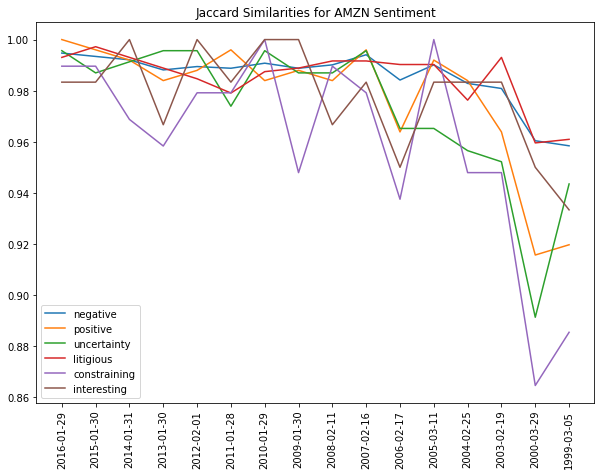

In [ ]:
plot_similarities(
    [jaccard_similarities[example_ticker][sentiment] for sentiment in sentiments],
    file_dates[example_ticker][1:],
    'Jaccard Similarities for {} Sentiment'.format(example_ticker),
    sentiments)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer


def get_tfidf(sentiment_words, docs):

    vectorizer = TfidfVectorizer(vocabulary = sentiment_words)
    X = vectorizer.fit_transform(docs)
    
    return X.toarray()


In [ ]:
sentiment_tfidf_ten_ks = {}

for ticker, ten_ks in ten_ks_by_ticker.items():
    lemma_docs = [' '.join(ten_k['file_lemma']) for ten_k in ten_ks]
    
    sentiment_tfidf_ten_ks[ticker] = {
        sentiment: get_tfidf(sentiment_df[sentiment_df[sentiment]]['word'], lemma_docs)
        for sentiment in sentiments}




In [ ]:

from sklearn.metrics.pairwise import cosine_similarity


def get_cosine_similarity(tfidf_matrix):
  
    N = tfidf_matrix.shape[0] - 1
    cosine_similarities = [cosine_similarity(tfidf_matrix[i].reshape(1,-1), tfidf_matrix[i+1].reshape(1,-1))[0,0]
                           for i in range(N)]
    
    return cosine_similarities


In [ ]:
cos_similarities={ ticker : {sentiment : get_cos_similarity(sentiment_values) for sentiment,sentiment_values in sentiment_by_ten_ks.items()} for ticker,sentiment_by_ten_ks in sentiment_tfidf_by_ticker.items()}

In [ ]:
cosine_similarities = {
    ticker: {
        sentiment_name: get_cosine_similarity(sentiment_values)
        for sentiment_name, sentiment_values in ten_k_sentiments.items()}
    for ticker, ten_k_sentiments in sentiment_tfidf_ten_ks.items()}

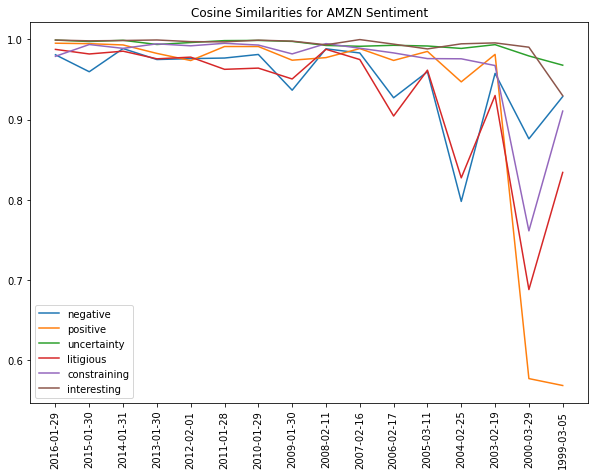

In [ ]:
plot_similarities(
    [cosine_similarities[example_ticker][sentiment] for sentiment in sentiments],
    file_dates[example_ticker][1:],
    'Cosine Similarities for {} Sentiment'.format(example_ticker),
    sentiments)

In [ ]:
import os
newpath = '/zip_data/daily' 
if not os.path.exists(newpath):
    os.makedirs(newpath)

In [ ]:
import pandas as pd
from pandas_datareader import data as wb
from pandas_datareader._utils import RemoteDataError

import bs4 as bs
import pickle
import requests

#ticker=['EQT', 'IRM', 'ANTM', 'EW', 'HPE', 'AIZ', 'VRSN', 'AXP', 'LUV', 'JNPR', 'EXPD', 'INFO', 'NWL', 'VRTX', 'MHK', 'AVY', 'HBI', 'GT', 'FMC', 'M', 'GILD', 'XRX', 'UAL', 'FOX', 'PCG', 'TROW', 'UHS', 'INTC', 'INCY', 'KR', 'OKE', 'LH', 'MU', 'CVS', 'LEG', 'PPL', 'ADS', 'BA', 'KSS', 'LOW', 'NFLX', 'EA', 'UDR', 'FB', 'BLL',  'CTSH', 'ED', 'ADP', 'ALB', 'PRGO', 'NI', 'FLIR', 'TXT', 'SCG', 'PXD', 'BLK', 'WAT', 'PBCT', 'BIIB', 'IPG', 'DOV', 'HRB', 'REGN', 'EFX', 'ADSK', 'NLSN', 'APD', 'LYB', 'MCHP', 'MDLZ', 'AMGN', 'CMI', 'AAL', 'QCOM', 'ZTS', 'APH', 'URI', 'GPN', 'PH', 'PGR', 'PX', 'HAL', 'NTAP', 'NRG', 'F', 'PNR', 'WEC', 'SNA', 'MAS', 'GOOGL', 'TAP', 'IP', 'DUK', 'CINF', 'HD', 'LNC', 'PFG', 'CTAS', 'NEM', 'BSX', 'AEE', 'SIG', 'EXR', 'CCL', 'WBA', 'XLNX', 'SWK', 'FRT', 'SPGI', 'MS', 'MPC', 'EL', 'NVDA', 'APA', 'AJG', 'EXC', 'GRMN', 'UPS', 'GPC', 'PDCO', 'TEL', 'NKE', 'SYMC', 'ALGN', 'HCP', 'SYY', 'BWA', 'SBAC', 'AOS', 'ULTA', 'KORS', 'DLR', 'QRVO', 'DXC', 'AYI', 'IR', 'CI', 'SLB', 'NTRS', 'FLS', 'L', 'MET', 'IVZ', 'GS', 'RJF', 'CMA', 'MO', 'LLL', 'DRI', 'DLTR', 'WMB', 'FBHS', 'GM', 'PFE', 'WRK', 'GGP', 'LMT', 'BBT', 'DVN', 'PG', 'SBUX', 'TDG', 'WHR', 'MGM', 'ETR', 'IFF', 'WYN', 'CPB', 'FL', 'ANSS', 'VZ', 'FAST', 'TGT', 'CL', 'BEN', 'HSIC', 'EQIX', 'OXY', 'MCD', 'ROP', 'BAX', 'ABBV', 'EQR', 'VRSK', 'LEN', 'CCI', 'XYL', 'FFIV', 'ETN', 'FIS', 'KMB', 'INTU', 'KIM', 'LUK', 'PLD', 'CTL', 'ABT', 'CMG', 'TXN', 'FE', 'ICE', 'NEE', 'DRE', 'MAT', 'VLO', 'FCX', 'PAYX', 'CSX', 'DISCK', 'TIF', 'CAG', 'JPM', 'MSFT', 'K', 'WLTW', 'PYPL', 'IDXX', 'EXPE', 'JNJ', 'MCO', 'PEP', 'HSY', 'AMZN', 'JCI', 'AET', 'TRIP', 'CRM', 'FLR', 'MSI', 'VAR', 'TMO', 'ADI', 'AZO', 'CME', 'ADM', 'SWKS', 'JBHT', 'DHI', 'SCHW', 'GLW', 'CSCO', 'WU', 'MRO', 'VIAB', 'ALK', 'ETFC', 'GWW', 'TRV', 'SNI', 'STI', 'VTR', 'FTI', 'CLX', 'AAP', 'DHR', 'NUE', 'PSX', 'XOM', 'DE', 'VNO', 'AON', 'BK', 'CXO', 'XRAY', 'ADBE', 'DISCA', 'MDT', 'ORLY', 'CNC', 'CHTR', 'AKAM', 'ZION', 'CB', 'CF', 'MA', 'CHRW', 'DFS', 'HES', 'NDAQ', 'KMI', 'CFG', 'HON', 'HCA', 'FITB', 'MAR', 'AEP', 'KLAC', 'NOV', 'TSN', 'DGX', 'PPG', 'XEC', 'LRCX', 'PM', 'XEL', 'REG', 'CA', 'BAC', 'ANDV', 'EOG', 'PSA', 'CMS', 'RTN', 'MTB', 'CBOE', 'AMP', 'AFL', 'BCR', 'CBG', 'FOXA', 'PNC', 'APC', 'PCAR', 'NSC', 'CAT', 'CBS', 'PKG', 'ITW', 'BBY', 'COP', 'HOLX', 'RHI', 'RRC', 'BMY', 'HAS', 'LNT', 'KEY', 'ARNC', 'MOS', 'JEC', 'WM', 'RF', 'ISRG', 'MRK', 'KO', 'A', 'SRE', 'EIX', 'UTX', 'PEG', 'RCL', 'ZBH', 'ARE', 'NWS', 'SNPS', 'PWR', 'GIS', 'RL', 'UNM', 'ALLE', 'AGN', 'MAA', 'COG', 'SYK', 'C', 'HLT', 'DAL', 'JWN', 'ORCL', 'WDC', 'ROK', 'KSU', 'ALXN', 'SHW', 'RE', 'HOG', 'SRCL', 'WY', 'TSCO', 'AMT', 'TSS', 'NOC', 'GOOG', 'LKQ', 'SJM', 'DIS', 'PHM', 'AIV', 'HRL', 'NAVI', 'SEE', 'DPS', 'MMC', 'NBL', 'MYL', 'VMC', 'WFC', 'FDX', 'CHD', 'PRU', 'HST', 'ABC', 'KMX', 'PVH', 'UNH', 'CNP', 'RHT', 'RSG', 'SLG', 'DVA', 'GE', 'HPQ', 'WYNN', 'OMC', 'EMR', 'PNW', 'HCN', 'SO', 'AWK', 'O', 'EBAY', 'COTY', 'AMG', 'LLY', 'AES', 'DISH', 'STT', 'USB', 'AIG', 'HBAN', 'ALL', 'ATVI', 'TJX', 'KHC', 'AMD', 'FISV', 'NFX', 'UA', 'YUM', 'MKC', 'ES', 'COF', 'AVGO', 'STX', 'D', 'TMK', 'LB', 'GD', 'DTE', 'SYF', 'BDX', 'COO', 'UAA', 'HIG', 'CELG', 'XL', 'HUM', 'MNST', 'T', 'HRS', 'BXP', 'WMT', 'CAH', 'LVLT', 'MAC', 'NWSA', 'CERN', 'MON', 'AME', 'EMN', 'RMD', 'HP', 'MTD', 'UNP', 'MLM', 'CTXS', 'EVHC', 'ILMN', 'VFC', 'ECL', 'STZ', 'MCK', 'IT', 'IBM', 'V', 'ACN', 'SPLS', 'DG', 'FTV', 'PKI', 'GPS', 'CHK', 'SPG', 'CMCSA', 'ROST', 'AAPL', 'CVX']
#ticker=['A', 'AAL', 'AAP', 'AAPL', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADS', 'ADSK', 'AEE', 'AEP', 'AES', 'AET', 'AFL', 'AGN', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK', 'ALL', 'ALLE', 'ALXN', 'AMD', 'AME', 'AMG', 'AMGN', 'AMP', 'AMT', 'AMZN', 'ANDV', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APC', 'APD', 'APH', 'ARE', 'ARNC', 'ATVI', 'AVGO', 'AVY', 'AWK', 'AXP', 'AYI', 'AZO', 'BA', 'BAC', 'BAX', 'BBT', 'BBY', 'BCR', 'BDX', 'BEN', 'BIIB', 'BK', 'BLK', 'BLL', 'BMY', 'BSX', 'BWA', 'BXP', 'C', 'CA', 'CAG', 'CAH', 'CAT', 'CB', 'CBG', 'CBOE', 'CBS', 'CCI', 'CCL', 'CELG', 'CERN', 'CF', 'CFG', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CI', 'CINF', 'CL', 'CLX', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP', 'COF', 'COG', 'COO', 'COP', 'COTY', 'CPB', 'CRM', 'CSCO', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS', 'CVS', 'CVX', 'CXO', 'D', 'DAL', 'DE', 'DFS', 'DG', 'DGX', 'DHI', 'DHR', 'DIS', 'DISCA', 'DISCK', 'DISH', 'DLR', 'DLTR', 'DOV', 'DPS', 'DRE', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'DXC', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQIX', 'EQR', 'EQT', 'ES', 'ETFC', 'ETN', 'ETR', 'EVHC', 'EW', 'EXC', 'EXPD', 'EXPE', 'EXR', 'F', 'FAST', 'FB', 'FBHS', 'FCX', 'FDX', 'FE', 'FFIV', 'FIS', 'FISV', 'FITB', 'FL', 'FLIR', 'FLR', 'FLS', 'FMC', 'FOX', 'FOXA', 'FRT', 'FTI', 'FTV', 'GD', 'GE', 'GGP', 'GILD', 'GIS', 'GLW', 'GM', 'GOOG', 'GOOGL', 'GPC', 'GPN', 'GPS', 'GRMN', 'GS', 'GT', 'GWW', 'HAL', 'HAS', 'HBAN', 'HBI', 'HCA', 'HCN', 'HCP', 'HD', 'HES', 'HIG', 'HLT', 'HOG', 'HOLX', 'HON', 'HP', 'HPE', 'HPQ', 'HRB', 'HRL', 'HRS', 'HSIC', 'HST', 'HSY', 'HUM', 'IBM', 'ICE', 'IDXX', 'IFF', 'ILMN', 'INCY', 'INFO', 'INTC', 'INTU', 'IP', 'IPG', 'IR', 'IRM', 'ISRG', 'IT', 'ITW', 'IVZ', 'JBHT', 'JCI', 'JEC', 'JNJ', 'JNPR', 'JPM', 'JWN', 'K', 'KEY', 'KHC', 'KIM', 'KLAC', 'KMB', 'KMI', 'KMX', 'KO', 'KORS', 'KR', 'KSS', 'KSU', 'L', 'LB', 'LEG', 'LEN', 'LH', 'LKQ', 'LLL', 'LLY', 'LMT', 'LNC', 'LNT', 'LOW', 'LRCX', 'LUK', 'LUV', 'LVLT', 'LYB', 'M', 'MA', 'MAA', 'MAC', 'MAR', 'MAS', 'MAT', 'MCD', 'MCHP', 'MCK', 'MCO', 'MDLZ', 'MDT', 'MET', 'MGM', 'MHK', 'MKC', 'MLM', 'MMC', 'MNST', 'MO', 'MON', 'MOS', 'MPC', 'MRK', 'MRO', 'MS', 'MSFT', 'MSI', 'MTB', 'MTD', 'MU', 'MYL', 'NAVI', 'NBL', 'NDAQ', 'NEE', 'NEM', 'NFLX', 'NFX', 'NI', 'NKE', 'NLSN', 'NOC', 'NOV', 'NRG', 'NSC', 'NTAP', 'NTRS', 'NUE', 'NVDA', 'NWL', 'NWS', 'NWSA', 'O', 'OKE', 'OMC', 'ORCL', 'ORLY', 'OXY', 'PAYX', 'PBCT', 'PCAR', 'PCG', 'PDCO', 'PEG', 'PEP', 'PFE', 'PFG', 'PG', 'PGR', 'PH', 'PHM', 'PKG', 'PKI', 'PLD', 'PM', 'PNC', 'PNR', 'PNW', 'PPG', 'PPL', 'PRGO', 'PRU', 'PSA', 'PSX', 'PVH', 'PWR', 'PX', 'PXD', 'PYPL', 'QCOM', 'QRVO', 'RCL', 'RE', 'REG', 'REGN', 'RF', 'RHI', 'RHT', 'RJF', 'RL', 'RMD', 'ROK', 'ROP', 'ROST', 'RRC', 'RSG', 'RTN', 'SBAC', 'SBUX', 'SCG', 'SCHW', 'SEE', 'SHW', 'SIG', 'SJM', 'SLB', 'SLG', 'SNA', 'SNI', 'SNPS', 'SO', 'SPG', 'SPGI', 'SPLS', 'SRCL', 'SRE', 'STI', 'STT', 'STX', 'STZ', 'SWK', 'SWKS', 'SYF', 'SYK', 'SYMC', 'SYY', 'T', 'TAP', 'TDG', 'TEL', 'TGT', 'TIF', 'TJX', 'TMK', 'TMO', 'TRIP', 'TROW', 'TRV', 'TSCO', 'TSN', 'TSS', 'TXN', 'TXT', 'UA', 'UAA', 'UAL', 'UDR', 'UHS', 'ULTA', 'UNH', 'UNM', 'UNP', 'UPS', 'URI', 'USB', 'UTX', 'V', 'VAR', 'VFC', 'VIAB', 'VLO', 'VMC', 'VNO', 'VRSK', 'VRSN', 'VRTX', 'VTR', 'VZ', 'WAT', 'WBA', 'WDC', 'WEC', 'WFC', 'WHR', 'WLTW', 'WM', 'WMB', 'WMT', 'WRK', 'WU', 'WY', 'WYN', 'WYNN', 'XEC', 'XEL', 'XL', 'XLNX', 'XOM', 'XRAY', 'XRX', 'XYL', 'YUM', 'ZBH', 'ZION', 'ZTS']
#ticker=['A', 'AAL', 'AAP', 'AAPL', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADS', 'ADSK', 'AEE', 'AEP', 'AES', 'AET', 'AFL', 'AGN', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK', 'ALL', 'ALLE', 'ALXN', 'AMD', 'AME', 'AMG', 'AMGN', 'AMP', 'AMT', 'AMZN', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APD', 'APH', 'ARE', 'ARNC', 'ATVI', 'AVGO', 'AVY', 'AWK', 'AXP', 'AYI', 'AZO', 'BA', 'BAC', 'BAX', 'BBY', 'BDX', 'BEN', 'BIIB', 'BK', 'BLK', 'BLL', 'BMY', 'BSX', 'BWA', 'BXP', 'C', 'CA', 'CAG', 'CAH', 'CAT', 'CB', 'CBOE', 'CBS', 'CCI', 'CCL', 'CERN', 'CF', 'CFG', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CI', 'CINF', 'CL', 'CLX', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP', 'COF', 'COG', 'COO', 'COP', 'COTY', 'CPB', 'CRM', 'CSCO', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS', 'CVS', 'CVX', 'CXO', 'D', 'DAL', 'DE', 'DFS', 'DG', 'DGX', 'DHI', 'DHR', 'DIS', 'DISCA', 'DISCK', 'DISH', 'DLR', 'DLTR', 'DOV', 'DRE', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'DXC', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQIX', 'EQR', 'EQT', 'ES', 'ETFC', 'ETN', 'ETR', 'EW', 'EXC', 'EXPD', 'EXPE', 'EXR', 'F', 'FAST', 'FB', 'FBHS', 'FCX', 'FDX', 'FE', 'FFIV', 'FIS', 'FISV', 'FITB', 'FL', 'FLIR', 'FLR', 'FLS', 'FMC', 'FOX', 'FOXA', 'FRT', 'FTI', 'FTV', 'GD', 'GE', 'GILD', 'GIS', 'GLW', 'GM', 'GOOG', 'GOOGL', 'GPC', 'GPN', 'GPS', 'GRMN', 'GS', 'GT', 'GWW', 'HAL', 'HAS', 'HBAN', 'HBI', 'HCA', 'HD', 'HES', 'HIG', 'HLT', 'HOG', 'HOLX', 'HON', 'HP', 'HPE', 'HPQ', 'HRB', 'HRL', 'HSIC', 'HST', 'HSY', 'HUM', 'IBM', 'ICE', 'IDXX', 'IFF', 'ILMN', 'INCY', 'INFO', 'INTC', 'INTU', 'IP', 'IPG', 'IR', 'IRM', 'ISRG', 'IT', 'ITW', 'IVZ', 'JBHT', 'JCI', 'JEC', 'JNJ', 'JNPR', 'JPM', 'JWN', 'K', 'KEY', 'KHC', 'KIM', 'KLAC', 'KMB', 'KMI', 'KMX', 'KO', 'KR', 'KSS', 'KSU', 'L', 'LB', 'LEG', 'LEN', 'LH', 'LKQ', 'LLY', 'LMT', 'LNC', 'LNT', 'LOW', 'LRCX', 'LUV', 'LYB', 'M', 'MA', 'MAA', 'MAC', 'MAR', 'MAS', 'MAT', 'MCD', 'MCHP', 'MCK', 'MCO', 'MDLZ', 'MDT', 'MET', 'MGM', 'MHK', 'MKC', 'MLM', 'MMC', 'MNST', 'MO', 'MON', 'MOS', 'MPC', 'MRK', 'MRO', 'MS', 'MSFT', 'MSI', 'MTB', 'MTD', 'MU', 'MYL', 'NAVI', 'NBL', 'NDAQ', 'NEE', 'NEM', 'NFLX', 'NKE', 'NLSN', 'NOC', 'NOV', 'NRG', 'NSC', 'NTAP', 'NTRS', 'NUE', 'NVDA', 'NWL', 'NWS', 'NWSA', 'O', 'OKE', 'OMC', 'ORCL', 'ORLY', 'OXY', 'PAYX', 'PBCT', 'PCAR', 'PCG', 'PDCO', 'PEG', 'PEP', 'PFE', 'PFG', 'PG', 'PGR', 'PH', 'PHM', 'PKG', 'PKI', 'PLD', 'PM', 'PNC', 'PNR', 'PNW', 'PPG', 'PPL', 'PRGO', 'PRU', 'PSA', 'PSX', 'PVH', 'PWR', 'PXD', 'PYPL', 'QCOM', 'QRVO', 'RCL', 'RE', 'REG', 'REGN', 'RF', 'RHI', 'RJF', 'RL', 'RMD', 'ROK', 'ROP', 'ROST', 'RRC', 'RSG', 'RTN', 'SBAC', 'SBUX', 'SCG', 'SCHW', 'SEE', 'SHW', 'SIG', 'SJM', 'SLB', 'SLG', 'SNA', 'SNPS', 'SO', 'SPG', 'SPGI', 'SRCL', 'SRE', 'STI', 'STT', 'STX', 'STZ', 'SWK', 'SWKS', 'SYF', 'SYK', 'SYY', 'T', 'TAP', 'TDG', 'TEL', 'TGT', 'TIF', 'TJX', 'TMO', 'TRIP', 'TROW', 'TRV', 'TSCO', 'TSN', 'TXN', 'TXT', 'UAA', 'UAL', 'UDR', 'UHS', 'ULTA', 'UNH', 'UNM', 'UNP', 'UPS', 'URI', 'USB', 'UTX', 'V', 'VAR', 'VFC', 'VLO', 'VMC', 'VNO', 'VRSK', 'VRSN', 'VRTX', 'VTR', 'VZ', 'WAT', 'WBA', 'WDC', 'WEC', 'WFC', 'WHR', 'WLTW', 'WM', 'WMB', 'WMT', 'WRK', 'WU', 'WY', 'WYNN', 'XEC', 'XEL', 'XLNX', 'XOM', 'XRAY', 'XRX', 'XYL', 'YUM', 'ZBH', 'ZION', 'ZTS']
#ticker=['A', 'AAL', 'AAP', 'AAPL', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADS', 'ADSK', 'AEE', 'AEP', 'AES', 'AET', 'AFL', 'AGN', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK', 'ALL', 'ALLE', 'ALXN', 'AMD', 'AME', 'AMG', 'AMGN', 'AMP', 'AMT', 'AMZN', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APD', 'APH', 'ARE', 'ARNC', 'ATVI', 'AVGO', 'AVY', 'AWK', 'AXP', 'AYI', 'AZO', 'BA', 'BAC', 'BAX', 'BBY', 'BDX', 'BEN', 'BIIB', 'BK', 'BLK', 'BLL', 'BMY', 'BSX', 'BWA', 'BXP', 'C', 'CAG', 'CAH', 'CAT', 'CB', 'CBOE', 'CBS', 'CCI', 'CCL', 'CERN', 'CF', 'CFG', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CI', 'CINF', 'CL', 'CLX', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP', 'COF', 'COG', 'COO', 'COP', 'COTY', 'CPB', 'CRM', 'CSCO', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS', 'CVS', 'CVX', 'CXO', 'D', 'DAL', 'DE', 'DFS', 'DG', 'DGX', 'DHI', 'DHR', 'DIS', 'DISCA', 'DISCK', 'DISH', 'DLR', 'DLTR', 'DOV', 'DRE', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'DXC', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQIX', 'EQR', 'EQT', 'ES', 'ETFC', 'ETN', 'ETR', 'EW', 'EXC', 'EXPD', 'EXPE', 'EXR', 'F', 'FAST', 'FB', 'FBHS', 'FCX', 'FDX', 'FE', 'FFIV', 'FIS', 'FISV', 'FITB', 'FL', 'FLIR', 'FLR', 'FLS', 'FMC', 'FOX', 'FOXA', 'FRT', 'FTI', 'FTV', 'GD', 'GE', 'GILD', 'GIS', 'GLW', 'GM', 'GOOG', 'GOOGL', 'GPC', 'GPN', 'GPS', 'GRMN', 'GS', 'GT', 'GWW', 'HAL', 'HAS', 'HBAN', 'HBI', 'HCA', 'HD', 'HES', 'HIG', 'HLT', 'HOG', 'HOLX', 'HON', 'HP', 'HPE', 'HPQ', 'HRB', 'HRL', 'HSIC', 'HST', 'HSY', 'HUM', 'IBM', 'ICE', 'IDXX', 'IFF', 'ILMN', 'INCY', 'INFO', 'INTC', 'INTU', 'IP', 'IPG', 'IR', 'IRM', 'ISRG', 'IT', 'ITW', 'IVZ', 'JBHT', 'JCI', 'JEC', 'JNJ', 'JNPR', 'JPM', 'JWN', 'K', 'KEY', 'KHC', 'KIM', 'KLAC', 'KMB', 'KMI', 'KMX', 'KO', 'KR', 'KSS', 'KSU', 'L', 'LB', 'LEG', 'LEN', 'LH', 'LKQ', 'LLY', 'LMT', 'LNC', 'LNT', 'LOW', 'LRCX', 'LUV', 'LYB', 'M', 'MA', 'MAA', 'MAC', 'MAR', 'MAS', 'MAT', 'MCD', 'MCHP', 'MCK', 'MCO', 'MDLZ', 'MDT', 'MET', 'MGM', 'MHK', 'MKC', 'MLM', 'MMC', 'MNST', 'MO', 'MON', 'MOS', 'MPC', 'MRK', 'MRO', 'MS', 'MSFT', 'MSI', 'MTB', 'MTD', 'MU', 'MYL', 'NAVI', 'NBL', 'NDAQ', 'NEE', 'NEM', 'NFLX', 'NKE', 'NLSN', 'NOC', 'NOV', 'NRG', 'NSC', 'NTAP', 'NTRS', 'NUE', 'NVDA', 'NWL', 'NWS', 'NWSA', 'O', 'OKE', 'OMC', 'ORCL', 'ORLY', 'OXY', 'PAYX', 'PBCT', 'PCAR', 'PCG', 'PDCO', 'PEG', 'PEP', 'PFE', 'PFG', 'PG', 'PGR', 'PH', 'PHM', 'PKG', 'PKI', 'PLD', 'PM', 'PNC', 'PNR', 'PNW', 'PPG', 'PPL', 'PRGO', 'PRU', 'PSA', 'PSX', 'PVH', 'PWR', 'PXD', 'PYPL', 'QCOM', 'QRVO', 'RCL', 'RE', 'REG', 'REGN', 'RF', 'RHI', 'RJF', 'RL', 'RMD', 'ROK', 'ROP', 'ROST', 'RRC', 'RSG', 'RTN', 'SBAC', 'SBUX', 'SCG', 'SCHW', 'SEE', 'SHW', 'SIG', 'SJM', 'SLB', 'SLG', 'SNA', 'SNPS', 'SO', 'SPG', 'SPGI', 'SRCL', 'SRE', 'STI', 'STT', 'STX', 'STZ', 'SWK', 'SWKS', 'SYF', 'SYK', 'SYY', 'T', 'TAP', 'TDG', 'TEL', 'TGT', 'TIF', 'TJX', 'TMO', 'TRIP', 'TROW', 'TRV', 'TSCO', 'TSN', 'TXN', 'TXT', 'UAA', 'UAL', 'UDR', 'UHS', 'ULTA', 'UNH', 'UNM', 'UNP', 'UPS', 'URI', 'USB', 'UTX', 'V', 'VAR', 'VFC', 'VLO', 'VMC', 'VNO', 'VRSK', 'VRSN', 'VRTX', 'VTR', 'VZ', 'WAT', 'WBA', 'WDC', 'WEC', 'WFC', 'WHR', 'WLTW', 'WM', 'WMB', 'WMT', 'WRK', 'WU', 'WY', 'WYNN', 'XEC', 'XEL', 'XLNX', 'XOM', 'XRAY', 'XRX', 'XYL', 'YUM', 'ZBH', 'ZION', 'ZTS']
ticker=['A', 'AAL', 'AAP', 'AAPL', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADS', 'ADSK', 'AEE', 'AEP', 'AES', 'AFL', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK', 'ALL', 'ALLE', 'ALXN', 'AMD', 'AME', 'AMG', 'AMGN', 'AMP', 'AMT', 'AMZN', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APD', 'APH', 'ARE', 'ARNC', 'ATVI', 'AVGO', 'AVY', 'AWK', 'AXP', 'AYI', 'AZO', 'BA', 'BAC', 'BAX', 'BBY', 'BDX', 'BEN', 'BIIB', 'BK', 'BLK', 'BLL', 'BMY', 'BSX', 'BWA', 'BXP', 'C', 'CAG', 'CAH', 'CAT', 'CB', 'CBOE', 'CCI', 'CCL', 'CERN', 'CF', 'CFG', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CI', 'CINF', 'CL', 'CLX', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP', 'COF', 'COG', 'COO', 'COP', 'COTY', 'CPB', 'CRM', 'CSCO', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS', 'CVS', 'CVX', 'CXO', 'D', 'DAL', 'DE', 'DFS', 'DG', 'DGX', 'DHI', 'DHR', 'DIS', 'DISCA', 'DISCK', 'DISH', 'DLR', 'DLTR', 'DOV', 'DRE', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'DXC', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQIX', 'EQR', 'EQT', 'ES', 'ETFC', 'ETN', 'ETR', 'EW', 'EXC', 'EXPD', 'EXPE', 'EXR', 'F', 'FAST', 'FB', 'FBHS', 'FCX', 'FDX', 'FE', 'FFIV', 'FIS', 'FISV', 'FITB', 'FL', 'FLIR', 'FLR', 'FLS', 'FMC', 'FOX', 'FOXA', 'FRT', 'FTI', 'FTV', 'GD', 'GE', 'GILD', 'GIS', 'GLW', 'GM', 'GOOG', 'GOOGL', 'GPC', 'GPN', 'GPS', 'GRMN', 'GS', 'GT', 'GWW', 'HAL', 'HAS', 'HBAN', 'HBI', 'HCA', 'HD', 'HES', 'HIG', 'HLT', 'HOG', 'HOLX', 'HON', 'HP', 'HPE', 'HPQ', 'HRB', 'HRL', 'HSIC', 'HST', 'HSY', 'HUM', 'IBM', 'ICE', 'IDXX', 'IFF', 'ILMN', 'INCY', 'INFO', 'INTC', 'INTU', 'IP', 'IPG', 'IR', 'IRM', 'ISRG', 'IT', 'ITW', 'IVZ', 'JBHT', 'JCI', 'JNJ', 'JNPR', 'JPM', 'JWN', 'K', 'KEY', 'KHC', 'KIM', 'KLAC', 'KMB', 'KMI', 'KMX', 'KO', 'KR', 'KSS', 'KSU', 'L', 'LB', 'LEG', 'LEN', 'LH', 'LKQ', 'LLY', 'LMT', 'LNC', 'LNT', 'LOW', 'LRCX', 'LUV', 'LYB', 'M', 'MA', 'MAA', 'MAC', 'MAR', 'MAS', 'MAT', 'MCD', 'MCHP', 'MCK', 'MCO', 'MDLZ', 'MDT', 'MET', 'MGM', 'MHK', 'MKC', 'MLM', 'MMC', 'MNST', 'MO', 'MOS', 'MPC', 'MRK', 'MRO', 'MS', 'MSFT', 'MSI', 'MTB', 'MTD', 'MU', 'MYL', 'NAVI', 'NBL', 'NDAQ', 'NEE', 'NEM', 'NFLX', 'NKE', 'NLSN', 'NOC', 'NOV', 'NRG', 'NSC', 'NTAP', 'NTRS', 'NUE', 'NVDA', 'NWL', 'NWS', 'NWSA', 'O', 'OKE', 'OMC', 'ORCL', 'ORLY', 'OXY', 'PAYX', 'PBCT', 'PCAR', 'PCG', 'PDCO', 'PEG', 'PEP', 'PFE', 'PFG', 'PG', 'PGR', 'PH', 'PHM', 'PKG', 'PKI', 'PLD', 'PM', 'PNC', 'PNR', 'PNW', 'PPG', 'PPL', 'PRGO', 'PRU', 'PSA', 'PSX', 'PVH', 'PWR', 'PXD', 'PYPL', 'QCOM', 'QRVO', 'RCL', 'RE', 'REG', 'REGN', 'RF', 'RHI', 'RJF', 'RL', 'RMD', 'ROK', 'ROP', 'ROST', 'RRC', 'RSG', 'SBAC', 'SBUX', 'SCG', 'SCHW', 'SEE', 'SHW', 'SIG', 'SJM', 'SLB', 'SLG', 'SNA', 'SNPS', 'SO', 'SPG', 'SPGI', 'SRCL', 'SRE', 'STT', 'STX', 'STZ', 'SWK', 'SWKS', 'SYF', 'SYK', 'SYY', 'T', 'TAP', 'TDG', 'TEL', 'TGT', 'TIF', 'TJX', 'TMO', 'TRIP', 'TROW', 'TRV', 'TSCO', 'TSN', 'TXN', 'TXT', 'UAA', 'UAL', 'UDR', 'UHS', 'ULTA', 'UNH', 'UNM', 'UNP', 'UPS', 'URI', 'USB', 'V', 'VAR', 'VFC', 'VLO', 'VMC', 'VNO', 'VRSK', 'VRSN', 'VRTX', 'VTR', 'VZ', 'WAT', 'WBA', 'WDC', 'WEC', 'WFC', 'WHR', 'WLTW', 'WM', 'WMB', 'WMT', 'WRK', 'WU', 'WY', 'WYNN', 'XEC', 'XEL', 'XLNX', 'XOM', 'XRAY', 'XRX', 'XYL', 'YUM', 'ZBH', 'ZION', 'ZTS']
print(len(ticker))
data=pd.DataFrame()



ch=0
u_ticker=[]

def load_file(ticker):
  cnt=0
  try:
    

    for i in ticker:

      datat1=wb.DataReader(i,start='2005-01-01',end='2020-01-01',data_source='yahoo')
      
      
      datat1.rename(columns={'High': 'high', 'Close': 'close', 'Volume': 'volume', 'Low': 'low', 'Open': 'open'}, inplace=True)
      datat1.to_csv('/zip_data/daily/{}.csv'.format(i))
      u_ticker.append(i)
      cnt=cnt+1
      
  
  except KeyError:
  
      ticker.pop(cnt)
      ticker=ticker[cnt:]
      load_file(ticker)
  except RemoteDataError:
    
    ticker.pop(cnt)
    ticker=ticker[cnt:]
    load_file(ticker)
  except OverflowError:
    ticker.pop(cnt)
    ticker=ticker[cnt:]
    load_file(ticker)

load_file(ticker)

In [ ]:
pip install zipline

In [ ]:
!pip install alphalens


In [ ]:
import os
newpath = '/root/.zipline/' 
if not os.path.exists(newpath):
    os.makedirs(newpath)

In [ ]:
import os
os.chdir('/root/.zipline/')

f= open("extension.py","w+")
f.write("""import pandas as pd

from zipline.data.bundles import register
from zipline.data.bundles.csvdir import csvdir_equities
end_session = pd.Timestamp('2020-01-03', tz='utc')
start_session = pd.Timestamp('2005-01-03', tz='utc')
register(
    'sp500',
    csvdir_equities(
        ['daily'],
        '/zip_data',
    ),
    calendar_name='NYSE', # US equities
    start_session=start_session,
    end_session=end_session
)""")

f.close()

In [ ]:
from pathlib import Path

data_folder = Path("/root/.zipline")
file_to_open = data_folder / "extension.py"

f = open(file_to_open)
print(f.read())

In [ ]:

!zipline ingest -b sp500

In [ ]:
bundle_name='sp500'
from zipline.data import bundles
from zipline.data.bundles.csvdir import csvdir_equities

# Create an ingest function 
ingest_func = csvdir_equities(['daily'], bundle_name)

# Register the data bundle and its ingest function
bundles.register(bundle_name, ingest_func);


# Load the data bundle
bundle_data = bundles.load(bundle_name)

In [ ]:
from zipline.pipeline import Pipeline
from zipline.pipeline.factors import AverageDollarVolume
universe= AverageDollarVolume(window_length=120).top(500)
pipeline=Pipeline()

In [ ]:
import pandas as pd
from zipline.pipeline.loaders import USEquityPricingLoader
from zipline.utils.calendars import get_calendar
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
pricing_loader=USEquityPricingLoader(bundle_data.equity_daily_bar_reader,bundle_data.adjustment_reader)
from zipline.pipeline.engine import SimplePipelineEngine
from zipline.pipeline.data import USEquityPricing
def choose_loader(columns):
  if columns not in USEquityPricing.columns:
    raise Exception("Column not present")
  else:
    return pricing_loader
trading_calendar= get_calendar('NYSE')
engine = SimplePipelineEngine(get_loader = choose_loader,calendar = trading_calendar.all_sessions, asset_finder= bundle_data.asset_finder)
start_date=pd.Timestamp('2019-12-24',tz='utc')
universe_end_date=pd.Timestamp('2019-12-24',tz='utc')
output=engine.run_pipeline(pipeline,start_date,universe_end_date)
universe_tickers=(output.index.get_level_values(1)).values.tolist()
print((len(universe_tickers)))
from zipline.data.data_portal import DataPortal
data_portal= DataPortal(bundle_data.asset_finder,
                        trading_calendar=trading_calendar,
                        first_trading_day=bundle_data.equity_daily_bar_reader.first_trading_day,
                        equity_daily_reader= bundle_data.equity_daily_bar_reader,
                        adjustment_reader= bundle_data.adjustment_reader)
start_date=universe_end_date-pd.DateOffset(years=12)
end_date=universe_end_date
def get_pricing(data_portal, assets, trading_calendar,start_date,end_date, field='close'):
  
  start_loc=trading_calendar.closes.index.get_loc(start_date)
  end_loc=trading_calendar.closes.index.get_loc(end_date)
  return data_portal.get_history_window(assets,end_date, bar_count=end_loc-start_loc,frequency='1d',field=field,data_frequency='daily')
returns_df=get_pricing(data_portal, universe_tickers, trading_calendar,end_date-pd.DateOffset(years=12),end_date)
#.pct_change()[1:].fillna(0) #best way to convert price into returns
#pricing = returns_df.pivot(index='date', columns='ticker', values='adj_close')
#returns_df.rename('date', axis='index')

#returns_df.columns.rename('ticker')
#returns_df.values.rename('adj_close')
#pricing = returns_df.pivot(index='date', columns='ticker', values='adj_close')

In [ ]:
import os
import glob
import pandas as pd
os.chdir("/zip_data/daily")

In [ ]:
extension = 'csv'
all_filenames = [i for i in glob.glob('*.{}'.format(extension))]

In [ ]:
#combine all files in the list
combined_csv = pd.concat([pd.read_csv(f) for f in all_filenames ])
#export to csv
combined_csv.to_csv( "combined.csv", index=False, encoding='utf-8-sig')

In [ ]:
cosine_similarities_df_dict = {'date': [], 'ticker': [], 'sentiment': [], 'value': []}


for ticker, ten_k_sentiments in cosine_similarities.items():
    for sentiment_name, sentiment_values in ten_k_sentiments.items():
        for sentiment_values, sentiment_value in enumerate(sentiment_values):
            cosine_similarities_df_dict['ticker'].append(ticker)
            cosine_similarities_df_dict['sentiment'].append(sentiment_name)
            cosine_similarities_df_dict['value'].append(sentiment_value)
            cosine_similarities_df_dict['date'].append(file_dates[ticker][1:][sentiment_values])

cosine_similarities_df = pd.DataFrame(cosine_similarities_df_dict)
cosine_similarities_df['date'] = pd.DatetimeIndex(cosine_similarities_df['date'])
cosine_similarities_df['date'] = pd.to_datetime(cosine_similarities_df['date'], format='%Y')


cosine_similarities_df

,date,sentiment,ticker,value
0,2016-01-29,negative,AMZN,0.980651
1,2015-01-30,negative,AMZN,0.959517
2,2014-01-31,negative,AMZN,0.988386
3,2013-01-30,negative,AMZN,0.974724
4,2012-02-01,negative,AMZN,0.975851
5,2011-01-28,negative,AMZN,0.976580
6,2010-01-29,negative,AMZN,0.981031
7,2009-01-30,negative,AMZN,0.936540
8,2008-02-11,negative,AMZN,0.988080
9,2007-02-16,negative,AMZN,0.982882


In [ ]:
pricing = pd.read_csv('/eod-quotemedia.csv')

In [ ]:
pricing = pricing.pivot(index='date', columns='ticker', values='adj_close')

In [ ]:
pricing

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,29.994186,16.176093,81.138217,53.109173,34.924478,50.863198,31.425388,64.694095,46.235,39.913360,...,27.668791,35.288928,76.320802,40.023873,22.106665,25.753386,45.480383,71.898827,27.858587,29.447893
2013-07-02,29.650137,15.819834,80.722073,54.312247,35.428076,50.696766,31.272881,64.712041,46.030,39.860576,...,27.542284,35.059033,76.608168,39.965530,22.082740,25.613675,45.402661,72.934172,28.038932,28.572441
2013-07-03,29.705185,16.127950,81.237299,54.612043,35.444862,50.937167,30.725650,65.214519,46.420,40.186077,...,27.334452,35.280086,76.650427,40.004426,22.202365,25.734758,46.063299,72.301458,28.181310,28.168387
2013-07-05,30.434568,16.214608,81.821882,54.173381,35.856134,51.371737,31.326707,66.075911,47.000,40.652334,...,27.695899,35.801771,77.394196,40.675380,22.585164,26.060750,46.413048,73.164246,29.396267,29.024598
2013-07-08,30.524021,16.310894,82.951417,53.865799,36.661889,52.037461,31.766285,66.820655,46.625,40.256455,...,27.985057,35.200507,77.968926,40.646208,22.489464,26.228403,46.950626,73.892823,29.576612,29.765365
2013-07-09,30.689164,16.715296,82.436190,54.813204,36.359731,51.695353,31.165229,66.488661,47.260,40.696320,...,28.319396,35.501139,78.890185,40.801791,22.489464,26.582338,47.280945,73.701088,28.912183,29.803846
2013-07-10,31.177714,16.532352,81.990322,54.602958,36.854935,52.287108,31.165229,66.712982,47.250,41.109793,...,27.957948,36.394194,78.450685,40.714276,22.967964,26.982842,47.083402,74.007856,28.323688,29.861568
2013-07-11,31.459834,16.724925,82.000230,55.454065,37.081554,53.720265,31.855995,67.475672,47.990,42.227051,...,28.500119,37.004300,78.831022,41.015719,23.231138,27.038727,46.543335,74.937749,27.849095,29.746124
2013-07-12,31.480477,16.907869,81.911056,55.353095,38.157241,53.988404,31.810963,67.762802,48.390,42.534956,...,28.924820,38.003461,78.940896,40.830963,23.494313,27.085297,45.964227,75.685496,28.447082,30.159799


In [ ]:

import alphalens as al


factor_data = {}
skipped_sentiments = []

for sentiment in sentiments:
    cs_df = cosine_similarities_df[(cosine_similarities_df['sentiment'] == sentiment)]
    cs_df = cs_df.pivot(index='date', columns='ticker', values='value')
    

    
    data = al.utils.get_clean_factor_and_forward_returns(cs_df.stack(), pricing, periods=[1])
    print(data)
    factor_data[sentiment] = data
    unixt_factor_data = {
    factor: data.set_index(pd.MultiIndex.from_tuples(
        [(x.timestamp(), y) for x, y in data.index.values],
        names=['date', 'asset']))
    for factor, data in factor_data.items()}
    

#if skipped_sentiments:
 #   print('\nSkipped the following sentiments:\n{}'.format('\n'.join(skipped_sentiments)))
factor_data[sentiments[0]].head()

AttributeError: ignored

In [ ]:
unixt_factor_data = {
    factor: data.set_index(pd.MultiIndex.from_tuples(
        [(x.timestamp(), y) for x, y in data.index.values],
        names=['date', 'asset']))
    for factor, data in factor_data.items()}

In [ ]:
ls_factor_returns = pd.DataFrame()

for factor_name, data in factor_data.items():
    ls_factor_returns[factor_name] = al.performance.factor_returns(data).iloc[:, 0]

(1 + ls_factor_returns).cumprod().plot()

TypeError: ignored

In [ ]:
qr_factor_returns = pd.DataFrame()

for factor_name, data in unixt_factor_data.items():
    qr_factor_returns[factor_name] = al.performance.mean_return_by_quantile(data)[0].iloc[:, 0]

(10000*qr_factor_returns).plot.bar(
    subplots=True,
    sharey=True,
    layout=(5,3),
    figsize=(14, 14),
    legend=False)

TypeError: ignored

In [ ]:

ls_FRA = pd.DataFrame()

for factor, data in unixt_factor_data.items():
    ls_FRA[factor] = al.performance.factor_rank_autocorrelation(data)

ls_FRA.plot(title="Factor Rank Autocorrelation")

TypeError: ignored

In [ ]:
daily_annualization_factor = np.sqrt(252)

(daily_annualization_factor * ls_factor_returns.mean() / ls_factor_returns.std()).round(2)

Series([], dtype: float64)